<a href="https://colab.research.google.com/github/786ak/786ak/blob/main/DeepFake_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np

#Kaggle dataset source link https://www.kaggle.com/c/deepfake-detection-challenge/data

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!unzip "/content/drive/MyDrive/train_sample_videos.zip"

Archive:  /content/drive/MyDrive/train_sample_videos.zip
   creating: train_sample_videos/
  inflating: train_sample_videos/aagfhgtpmv.mp4  
  inflating: train_sample_videos/aapnvogymq.mp4  
  inflating: train_sample_videos/abarnvbtwb.mp4  
  inflating: train_sample_videos/abofeumbvv.mp4  
  inflating: train_sample_videos/abqwwspghj.mp4  
  inflating: train_sample_videos/acifjvzvpm.mp4  
  inflating: train_sample_videos/acqfdwsrhi.mp4  
  inflating: train_sample_videos/acxnxvbsxk.mp4  
  inflating: train_sample_videos/acxwigylke.mp4  
  inflating: train_sample_videos/aczrgyricp.mp4  
  inflating: train_sample_videos/adhsbajydo.mp4  
  inflating: train_sample_videos/adohikbdaz.mp4  
  inflating: train_sample_videos/adylbeequz.mp4  
  inflating: train_sample_videos/aelfnikyqj.mp4  
  inflating: train_sample_videos/aelzhcnwgf.mp4  
  inflating: train_sample_videos/aettqgevhz.mp4  
  inflating: train_sample_videos/aevrfsexku.mp4  
  inflating: train_sample_videos/afoovlsmtx.mp4  
  inflati

In [ ]:
data = pd.read_json("train_sample_videos/metadata.json")

In [ ]:
data

,aagfhgtpmv.mp4,aapnvogymq.mp4,abarnvbtwb.mp4,abofeumbvv.mp4,abqwwspghj.mp4,acifjvzvpm.mp4,acqfdwsrhi.mp4,acxnxvbsxk.mp4,acxwigylke.mp4,aczrgyricp.mp4,adhsbajydo.mp4,adohikbdaz.mp4,adylbeequz.mp4,aelfnikyqj.mp4,aelzhcnwgf.mp4,aettqgevhz.mp4,aevrfsexku.mp4,afoovlsmtx.mp4,agdkmztvby.mp4,agqphdxmwt.mp4,agrmhtjdlk.mp4,ahbweevwpv.mp4,ahdbuwqxit.mp4,ahfazfbntc.mp4,ahqqqilsxt.mp4,aipfdnwpoo.mp4,ajqslcypsw.mp4,ajwpjhrbcv.mp4,aklqzsddfl.mp4,aknbdpmgua.mp4,aknmpoonls.mp4,akvmwkdyuv.mp4,akxoopqjqz.mp4,akzbnazxtz.mp4,aladcziidp.mp4,alaijyygdv.mp4,alninxcyhg.mp4,altziddtxi.mp4,alvgwypubw.mp4,amaivqofda.mp4,...,ehevsxtecd.mp4,ehfiekigla.mp4,ehieahnhte.mp4,ehtdtkmmli.mp4,eiriyukqqy.mp4,eivxffliio.mp4,eiwopxzjfn.mp4,eixwxvxbbn.mp4,ejkqesyvam.mp4,ekcrtigpab.mp4,ekhacizpah.mp4,ekkdjkirzq.mp4,elginszwtk.mp4,ellavthztb.mp4,elvvackpjh.mp4,emaalmsonj.mp4,emfbhytfhc.mp4,emgjphonqb.mp4,ensyyivobf.mp4,eoewqcpbgt.mp4,eprybmbpba.mp4,epymyyiblu.mp4,eqjscdagiv.mp4,eqnoqyfquo.mp4,eqvuznuwsa.mp4,erlvuvjsjf.mp4,erqgqacbqe.mp4,errocgcham.mp4,esckbnkkvb.mp4,esgftaficx.mp4,esnntzzajv.mp4,esxrvsgpvb.mp4,esyhwdfnxs.mp4,esyrimvzsa.mp4,etdcqxabww.mp4,etejaapnxh.mp4,etmcruaihe.mp4,etohcvnzbj.mp4,eudeqjhdfd.mp4,eukvucdetx.mp4
label,FAKE,FAKE,REAL,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,REAL,FAKE,FAKE,FAKE,REAL,FAKE,FAKE,REAL,FAKE,FAKE,FAKE,REAL,FAKE,REAL,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,...,FAKE,FAKE,FAKE,REAL,FAKE,FAKE,FAKE,FAKE,FAKE,REAL,FAKE,FAKE,FAKE,REAL,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,REAL,FAKE,REAL,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,FAKE,REAL,FAKE
split,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,...,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train,train
original,vudstovrck.mp4,jdubbvfswz.mp4,None,atvmxvwyns.mp4,qzimuostzz.mp4,kbvibjhfzo.mp4,ccfoszqabv.mp4,fjlyaizcwc.mp4,ffcwhpnpuw.mp4,slwkmefgde.mp4,fysyrqfguw.mp4,qjlhemtkxk.mp4,dlpoieqvfb.mp4,None,qzimuostzz.mp4,proiippuup.mp4,gxembgiarp.mp4,None,iufotyxgzb.mp4,aytzyidmgs.mp4,None,dkuayagnmc.mp4,jomvcqqars.mp4,sunqwnmlkx.mp4,None,ygdgwyqyut.mp4,None,bzythlfnhq.mp4,lyvlnqduqg.mp4,yxyhvdlrgk.mp4,swedbyuehz.mp4,xlbnmndmku.mp4,meawmsgiti.mp4,ppdpgwyjgm.mp4,fewcljwqkr.mp4,cppdvdejkc.mp4,tqhbgzfwsf.mp4,meawmsgiti.mp4,vcxckqbaya.mp4,xobhsemxmv.mp4,...,nzquxipbye.mp4,avmjormvsx.mp4,sasoxcqisz.mp4,None,ixuouyigxa.mp4,joeifeskbs.mp4,xzvrgckqkz.mp4,ywvlvpvroj.mp4,jwcsqxzdlv.mp4,None,egghxjjmfg.mp4,tivkmbqgwp.mp4,gipbyjfxfp.mp4,None,qhkqqfznrg.mp4,dzyuwjkjui.mp4,cprhtltsjp.mp4,ybjrqnqnno.mp4,lulmevqtla.mp4,gbqrgajyca.mp4,kuelhabsmz.mp4,svcnlasmeh.mp4,dbnygxtwek.mp4,None,cmbzllswnl.mp4,None,nvpluswotp.mp4,grnycmbdfu.mp4,gdfyzwykty.mp4,rrcsuwgpnd.mp4,ybetenmsye.mp4,gomwfvijiv.mp4,qeumxirsme.mp4,qzklcjjxdq.mp4,gipbyjfxfp.mp4,wtreibcmgm.mp4,afoovlsmtx.mp4,bdnaqemxmr.mp4,None,gjypopglvi.mp4


In [ ]:
import dlib
import cv2
import os
import re
import json
from PIL import Image, ImageChops, ImageEnhance
from imutils import paths
import matplotlib.pyplot as plt

In [ ]:
train_frame_folder = '/content/train_sample_videos'
with open(os.path.join("/content/train_sample_videos", 'metadata.json'), 'r') as file:
    data = json.load(file)
list_of_train_data = [f for f in os.listdir(train_frame_folder) if f.endswith('.mp4')]
detector = dlib.get_frontal_face_detector()
for vid in list_of_train_data[:20]:
    count = 0
    cap = cv2.VideoCapture(os.path.join(train_frame_folder, vid))
    frameRate = cap.get(5)
    while cap.isOpened():
        frameId = cap.get(1)
        ret, frame = cap.read()
        if ret != True:
            break
        if frameId % ((int(frameRate)+1)*1) == 0:
            face_rects, scores, idx = detector.run(frame, 0)
            for i, d in enumerate(face_rects):
                x1 = d.left()
                y1 = d.top()
                x2 = d.right()
                y2 = d.bottom()
                crop_img = frame[y1:y2, x1:x2] 
                if data[vid]['label'] == 'REAL':
                    cv2.imwrite('/content/drive/MyDrive/dataset/REAL'+vid.split('.')[0]+'_'+str(count)+'.png', cv2.resize(crop_img, (128, 128)))
                elif data[vid]['label'] == 'FAKE':
                    cv2.imwrite('/content/drive/MyDrive/dataset/FAKE'+vid.split('.')[0]+'_'+str(count)+'.png', cv2.resize(crop_img, (128, 128)))
                count+=1

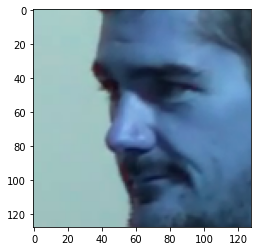

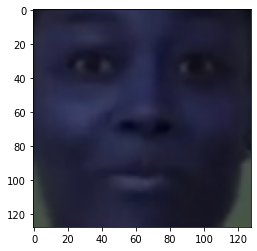

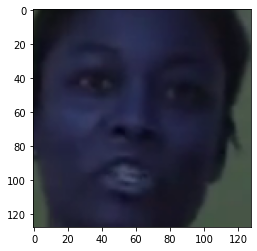

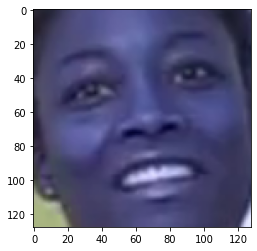

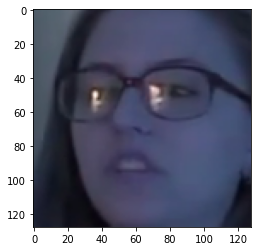

...

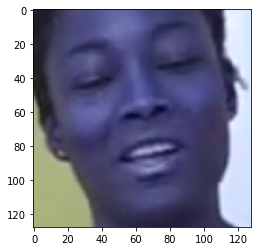

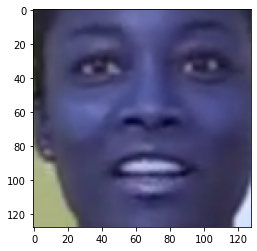

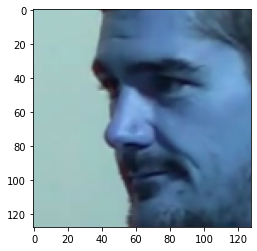

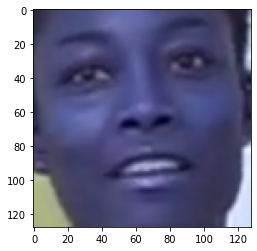

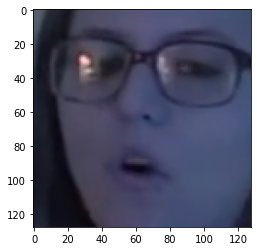

In [ ]:
real = list(paths.list_images("/content/dataset/REAL"))
fake = list(paths.list_images("/content/dataset/FAKE"))
for i in range(len(real)):
  testim = cv2.imread(real[i])
  plt.imshow(testim)
  plt.show()

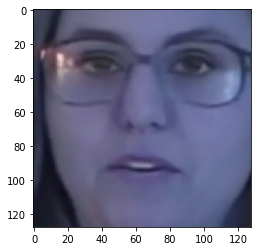

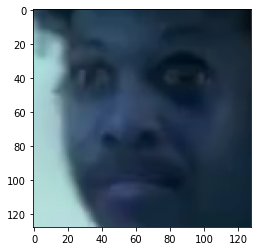

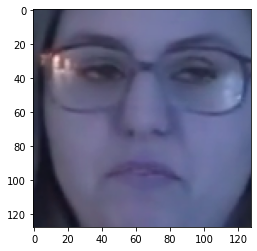

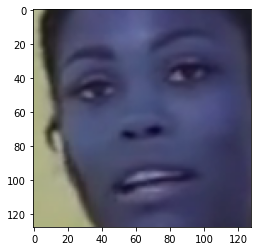

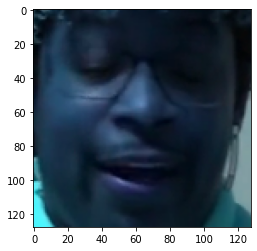

...

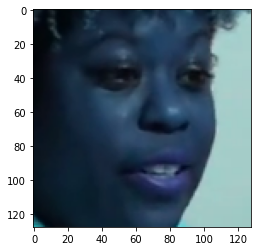

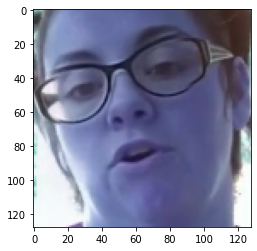

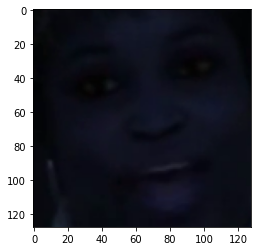

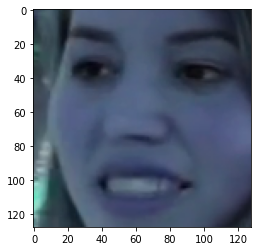

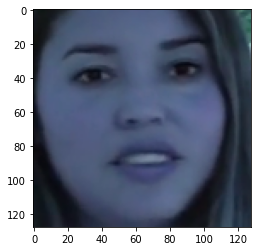

In [ ]:
for i in range(len(real)):
  testim = cv2.imread(fake[i])
  plt.imshow(testim)
  plt.show()

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sn
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

In [ ]:
input_shape = (128, 128, 3)
data_dir = 'dataset'
real_data = [f for f in os.listdir(data_dir+'/REAL') if f.endswith('.png')]
fake_data = [f for f in os.listdir(data_dir+'/FAKE') if f.endswith('.png')]
X = []
Y = []
for img in real_data:
    X.append(img_to_array(load_img(data_dir+'/REAL/'+img)).flatten() / 255.0)
    Y.append(1)
for img in fake_data:
    X.append(img_to_array(load_img(data_dir+'/FAKE/'+img)).flatten() / 255.0)
    Y.append(0)
Y_val_org = Y
#Normalization
X = np.array(X)
Y = to_categorical(Y, 2)
#Reshape
X = X.reshape(-1, 128, 128, 3)
#Train-Test split
X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size = 0.2, random_state=5)

In [ ]:
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras import optimizers
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

googleNet_model = InceptionResNetV2(include_top=False, weights='imagenet', input_shape=input_shape)
googleNet_model.trainable = True
datagen = ImageDataGenerator(
    featurewise_center=True,
    featurewise_std_normalization=True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    validation_split=0.2)
datagen.fit(X_train)
model = Sequential()
model.add(googleNet_model)
model.add(GlobalAveragePooling2D())
model.add(Dense(units=2, activation='softmax'))
model.compile(loss='binary_crossentropy',
              optimizer=optimizers.Adam(learning_rate=1e-5, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False),
              metrics=['accuracy'])
model.summary()

219062272/219055592 [==============================] - 5s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_resnet_v2 (Functio (None, 2, 2, 1536)        54336736  
_________________________________________________________________
global_average_pooling2d (Gl (None, 1536)              0         
_________________________________________________________________
dense (Dense)                (None, 2)                 3074      
Total params: 54,339,810
Trainable params: 54,279,266
Non-trainable params: 60,544
_________________________________________________________________


In [ ]:
import datetime
log_dir = "/content/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True)
callback_list=[tensorboard_callback]

In [ ]:
EPOCHS = 100
BATCH_SIZE = 64
history = model.fit(datagen.flow(X_train, Y_train,batch_size=32), batch_size = BATCH_SIZE, epochs = EPOCHS, validation_data = datagen.flow(X_val, Y_val), verbose = 1,callbacks=callback_list)

Epoch 1/100
94/94 [==============================] - 115s 678ms/step - loss: 0.6429 - accuracy: 0.6512 - val_loss: 0.5978 - val_accuracy: 0.7250
Epoch 2/100
94/94 [==============================] - 54s 578ms/step - loss: 0.5506 - accuracy: 0.7674 - val_loss: 0.6096 - val_accuracy: 0.7623
Epoch 3/100
94/94 [==============================] - 55s 580ms/step - loss: 0.4873 - accuracy: 0.8071 - val_loss: 0.8734 - val_accuracy: 0.8318
Epoch 4/100
94/94 [==============================] - 54s 578ms/step - loss: 0.4325 - accuracy: 0.8401 - val_loss: 1.2076 - val_accuracy: 0.8411
Epoch 5/100
94/94 [==============================] - 54s 577ms/step - loss: 0.3862 - accuracy: 0.8598 - val_loss: 1.1366 - val_accuracy: 0.8545
Epoch 6/100
94/94 [==============================] - 55s 578ms/step - loss: 0.3453 - accuracy: 0.8775 - val_loss: 1.3165 - val_accuracy: 0.8919
Epoch 7/100
94/94 [==============================] - 55s 583ms/step - loss: 0.3051 - accuracy: 0.8915 - val_loss: 5.2325 - val_accuracy

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir /content/20210621-161539

<IPython.core.display.Javascript object>

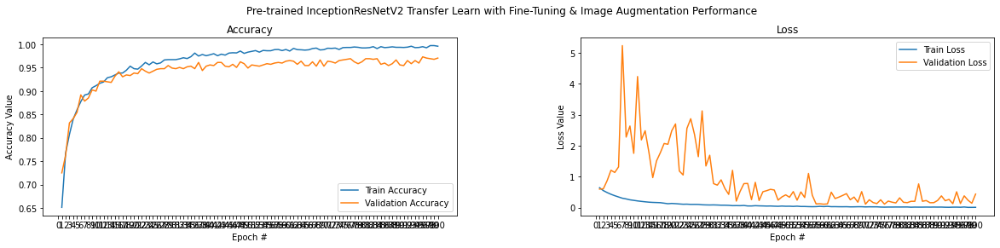

In [ ]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
t = f.suptitle('Pre-trained InceptionResNetV2 Transfer Learn with Fine-Tuning & Image Augmentation Performance ', fontsize=12)
f.subplots_adjust(top=0.85, wspace=0.3)

epoch_list = list(range(1,EPOCHS+1))
ax1.plot(epoch_list, history.history['accuracy'], label='Train Accuracy')
ax1.plot(epoch_list, history.history['val_accuracy'], label='Validation Accuracy')
ax1.set_xticks(np.arange(0, EPOCHS+1, 1))
ax1.set_ylabel('Accuracy Value')
ax1.set_xlabel('Epoch #')
ax1.set_title('Accuracy')
l1 = ax1.legend(loc="best")

ax2.plot(epoch_list, history.history['loss'], label='Train Loss')
ax2.plot(epoch_list, history.history['val_loss'], label='Validation Loss')
ax2.set_xticks(np.arange(0, EPOCHS+1, 1))
ax2.set_ylabel('Loss Value')
ax2.set_xlabel('Epoch #')
ax2.set_title('Loss')
l2 = ax2.legend(loc="best")

True positive =  2913
False positive =  73
False negative =  416
True negative =  343




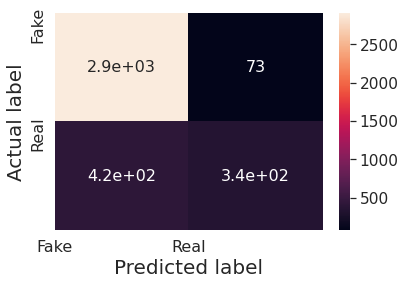

In [ ]:
#Output confusion matrix
def print_confusion_matrix(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    print('True positive = ', cm[0][0])
    print('False positive = ', cm[0][1])
    print('False negative = ', cm[1][0])
    print('True negative = ', cm[1][1])
    print('\n')
    df_cm = pd.DataFrame(cm, range(2), range(2))
    sn.set(font_scale=1.4) # for label size
    sn.heatmap(df_cm, annot=True, annot_kws={"size": 16}) # font size
    plt.ylabel('Actual label', size = 20)
    plt.xlabel('Predicted label', size = 20)
    plt.xticks(np.arange(2), ['Fake', 'Real'], size = 16)
    plt.yticks(np.arange(2), ['Fake', 'Real'], size = 16)
    plt.ylim([2, 0])
    plt.show()
print_confusion_matrix(Y_val_org, np.argmax(model.predict(X), axis=-1))